In [1]:
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from glob import glob

In [2]:
import os

In [3]:
dataset_path = os.path.join(os.getcwd(), 'jute+pest+dataset', 'Jute_Pest_Dataset')

In [4]:
%matplotlib inline

### method one for viewing images

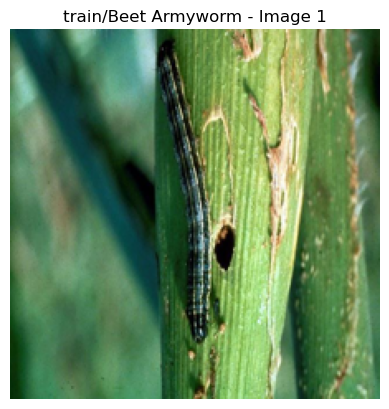

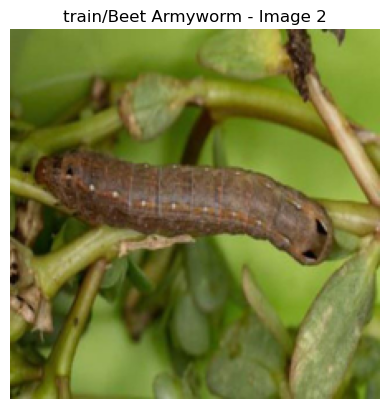

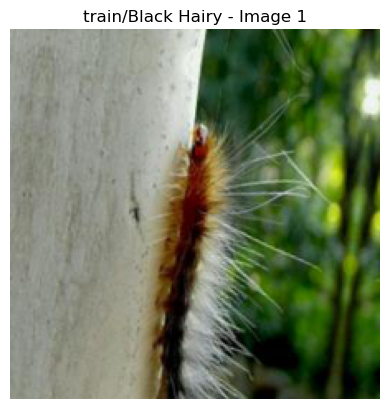

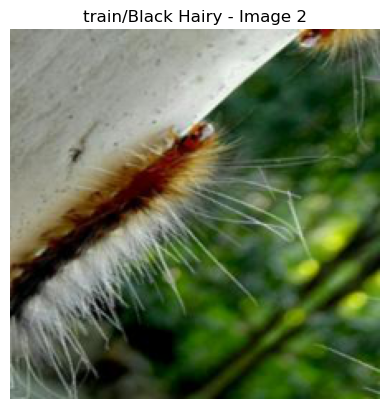

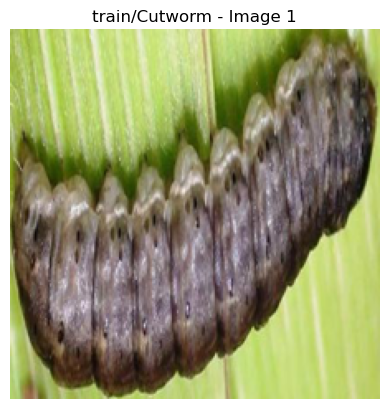

...

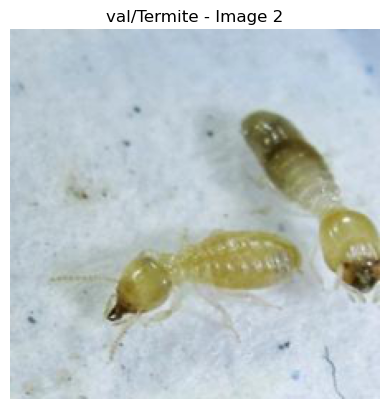

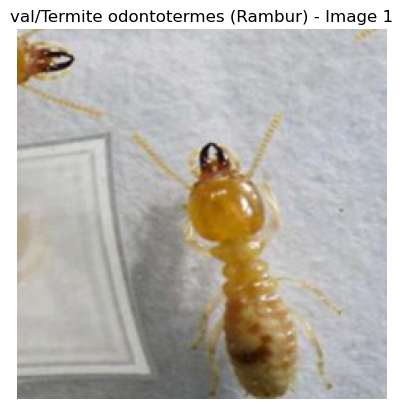

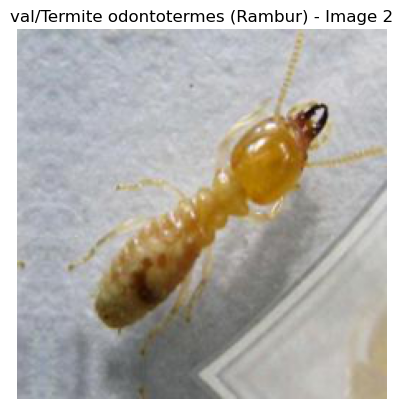

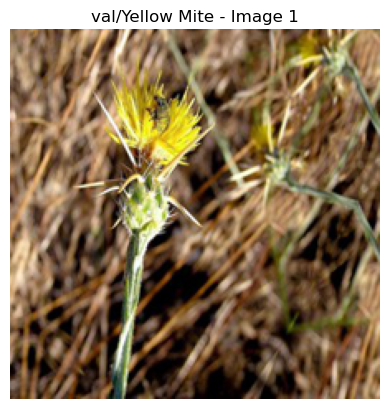

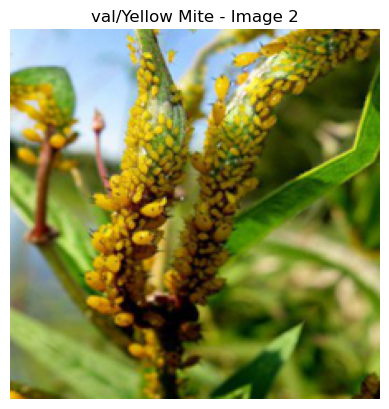

In [5]:
resized_images = []
labels = []
for folder in ['train', 'test', 'val']:
    image_folders = os.path.join(dataset_path, folder)
    for image_folder in os.listdir(image_folders):
        image_path = os.path.join(image_folders, image_folder)
        for idx, file in enumerate(os.listdir(image_path)):
            if file.endswith((".jpg", '.png', '.jpeg')):
                file_path = os.path.join(image_path, file)
                if idx < 2:
                    try:
                        with Image.open(file_path) as img:
                            resized_img = img.resize((224, 224))
                            plt.imshow(resized_img)
                            plt.axis('off')
                            plt.title(F'{folder}/{image_folder} - Image {idx + 1}')
                            plt.show()
                            
                    except FileNotFoundError as F:
                        print(F)
    

### Second method is to use the keras image method

In [5]:
one_img = r'C:\Users\HP\OneDrive\Desktop\project-folder\jute_pest_class\jute+pest+dataset\Jute_Pest_Dataset\test\Beet Armyworm\Image_41_jpg.rf.8a00cbcc5ad8512f15cc590210befa6a.jpg'

In [6]:
img = image.load_img(one_img, target_size=(224, 224))

In [7]:
%matplotlib inline

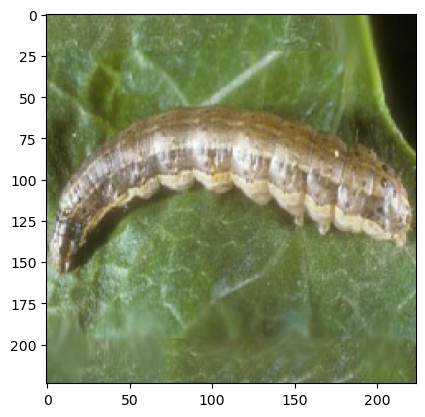

In [8]:
plt.imshow(img)
plt.show()

### Third method

In [9]:
import cv2

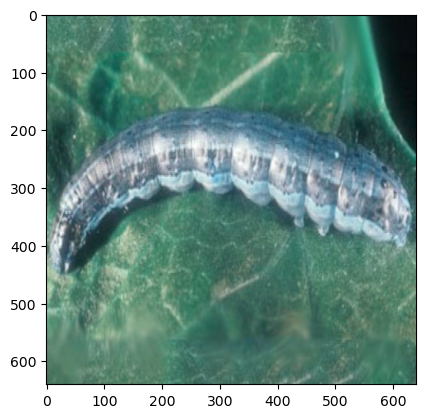

In [10]:
img = cv2.imread(filename=one_img)

plt.imshow(img)
plt.show()

In [11]:
import PIL
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing import image_dataset_from_directory

In [12]:
train_dir_path = os.path.join(dataset_path, 'train')
val_dir_path = os.path.join(dataset_path, 'val')
test_dir_path = os.path.join(dataset_path, 'test')

In [1]:
'm'.upper()

'M'

In [13]:
batch_size = 32
img_width = 256
img_height = 256

train_ds = image_dataset_from_directory(
    directory = train_dir_path,
    color_mode = 'rgb',
    image_size = (img_height, img_width),
    batch_size = batch_size
)

class_names = train_ds.class_names

print(class_names)

Found 6443 files belonging to 17 classes.
['Beet Armyworm', 'Black Hairy', 'Cutworm', 'Field Cricket', 'Jute Aphid', 'Jute Hairy', 'Jute Red Mite', 'Jute Semilooper', 'Jute Stem Girdler', 'Jute Stem Weevil', 'Leaf Beetle', 'Mealybug', 'Pod Borer', 'Scopula Emissaria', 'Termite', 'Termite odontotermes (Rambur)', 'Yellow Mite']


In [14]:
val_ds = image_dataset_from_directory(
    directory = val_dir_path,
    color_mode = 'rgb',
    image_size = (img_height, img_width),
    batch_size = batch_size
)

test_ds = image_dataset_from_directory(
    directory = test_dir_path,
    color_mode = 'rgb', 
    image_size = (img_height, img_width),
    batch_size = batch_size
)

Found 413 files belonging to 17 classes.


Found 379 files belonging to 17 classes.


In [15]:
train_ds.take(1)

<_TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

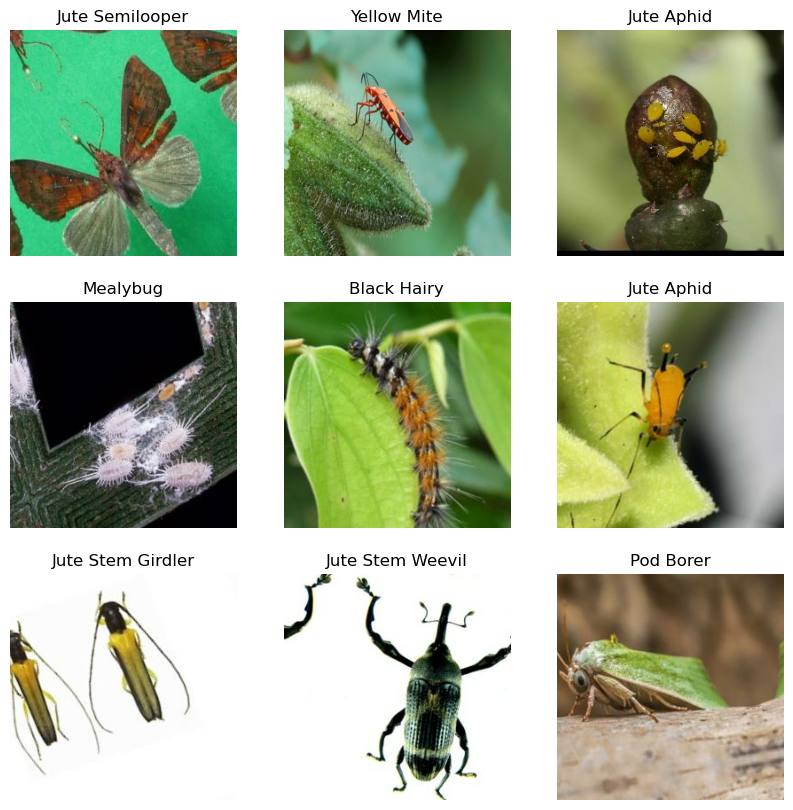

In [16]:
plt.figure(figsize=(10,10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3,3,i+1)
        plt.imshow(images[i].numpy().astype('uint8'))
        plt.title(class_names[labels[i]])
        plt.axis('off')
plt.show()
        

In [17]:
for image_batch, labels_batch in train_ds:
    print(image_batch.shape)
    print(labels_batch.shape)
    break

(32, 256, 256, 3)
(32,)


### Configure dataset for performance

In [18]:
AUTOTUNE = tf.data.AUTOTUNE

In [19]:
train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
val_ds   = val_ds.cache().prefetch(buffer_size=AUTOTUNE)
test_ds  = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

### Let's Create a basic Keras model

In [20]:
num_classes = len(class_names)
print(num_classes)

17


In [21]:
from tensorflow.keras import layers

In [22]:
model = Sequential(
    [
        layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
        layers.Conv2D(16, 3, padding='same', activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(32, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(64, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(num_classes, activation='softmax')
    ]
)

c:\Users\HP\anaconda3\Lib\site-packages\keras\src\layers\preprocessing\tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [23]:
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

In [24]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ rescaling (Rescaling)           │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 256, 256, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 128, 128, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 128, 128, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 65536)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     8,388,736 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 17)             │         2,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,414,513 (32.10 MB)

 Trainable params: 8,414,513 (32.10 MB)

 Non-trainable params: 0 (0.00 B)

In [25]:
epochs = 7
history = model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = epochs
)

Epoch 1/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 320s 2s/step - accuracy: 0.1528 - loss: 2.7556 - val_accuracy: 0.3898 - val_loss: 2.1887
Epoch 2/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 259s 1s/step - accuracy: 0.3953 - loss: 1.8889 - val_accuracy: 0.4165 - val_loss: 2.1891
Epoch 3/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 383s 2s/step - accuracy: 0.5447 - loss: 1.4145 - val_accuracy: 0.4794 - val_loss: 2.3159
Epoch 4/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 419s 2s/step - accuracy: 0.6892 - loss: 0.9788 - val_accuracy: 0.5206 - val_loss: 2.6995
Epoch 5/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - accuracy: 0.8128 - loss: 0.6245 - val_accuracy: 0.5375 - val_loss: 3.4079
Epoch 6/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 317s 1s/step - accuracy: 0.8804 - loss: 0.4042 - val_accuracy: 0.5860 - val_loss: 3.0870
Epoch 7/7
202/202 ━━━━━━━━━━━━━━━━━━━━ 279s 1s/step - accuracy: 0.9093 - loss: 0.3021 - val_accuracy: 0.5617 - val_loss: 3.1283


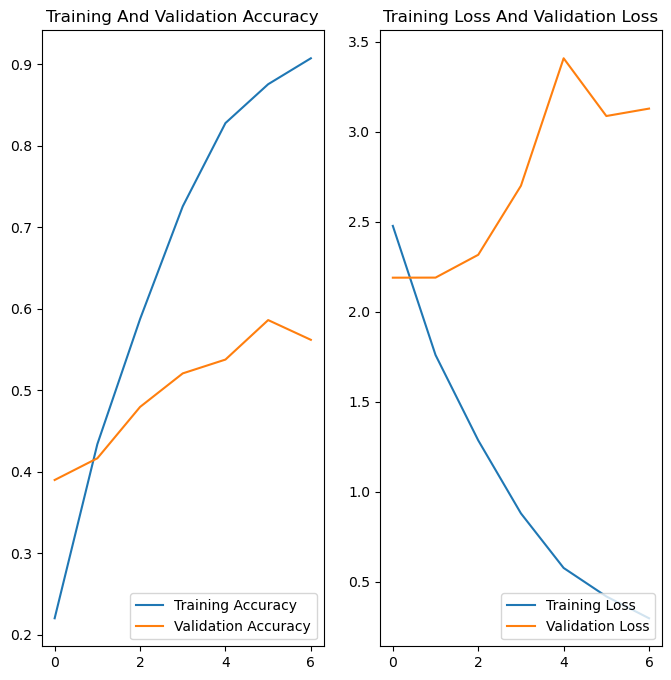

In [26]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)
plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc = 'lower right')
plt.title('Training And Validation Accuracy')


plt.subplot(1,2,2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc = 'lower right')
plt.title('Training Loss And Validation Loss')

plt.show()

### Inference

> This is a serious case of overfitting, The difference between the training and validation accuracies are typically wide, the losses are minimal for train but maximum for validation

In [27]:
data_augmentation = keras.Sequential(
    [
        layers.RandomFlip('horizontal', input_shape=(img_height, img_width, 3)),
        layers.RandomRotation(0.1),
        layers.RandomZoom(0.1)
    ]
)

In [28]:
model = Sequential(
    [
        data_augmentation,
        layers.Rescaling (1./255),
        layers.Conv2D(16, 3, padding='same', activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(32, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(64, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Dropout(0.2),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(num_classes, activation='softMax'.lower())
    ]
)

model.compile(
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer = 'adam',
    metrics = ['accuracy']
)

In [29]:
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_1 (Sequential)       │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_1 (Rescaling)         │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 256, 256, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 128, 128, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 128, 128, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 65536)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 128)            │     8,388,736 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 17)             │         2,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,414,513 (32.10 MB)

 Trainable params: 8,414,513 (32.10 MB)

 Non-trainable params: 0 (0.00 B)

In [30]:
epochs = 15

history = model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = epochs
)

Epoch 1/15


c:\Users\HP\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\nn.py:678: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


202/202 ━━━━━━━━━━━━━━━━━━━━ 266s 1s/step - accuracy: 0.1349 - loss: 2.8363 - val_accuracy: 0.3898 - val_loss: 2.1298
Epoch 2/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 319s 2s/step - accuracy: 0.3708 - loss: 1.9648 - val_accuracy: 0.4770 - val_loss: 1.8596
Epoch 3/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 292s 1s/step - accuracy: 0.4986 - loss: 1.5677 - val_accuracy: 0.5496 - val_loss: 1.8391
Epoch 4/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 336s 2s/step - accuracy: 0.5831 - loss: 1.3091 - val_accuracy: 0.5690 - val_loss: 1.7217
Epoch 5/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 315s 2s/step - accuracy: 0.6603 - loss: 1.0967 - val_accuracy: 0.5642 - val_loss: 1.9879
Epoch 6/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 346s 2s/step - accuracy: 0.7163 - loss: 0.9136 - val_accuracy: 0.5617 - val_loss: 2.1126
Epoch 7/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 339s 2s/step - accuracy: 0.7387 - loss: 0.8082 - val_accuracy: 0.5448 - val_loss: 2.2991
Epoch 8/15
202/202 ━━━━━━━━━━━━━━━━━━━━ 344s 2s/step - accuracy: 0.7541 - loss: 0.7681 - val_accuracy: 0.588

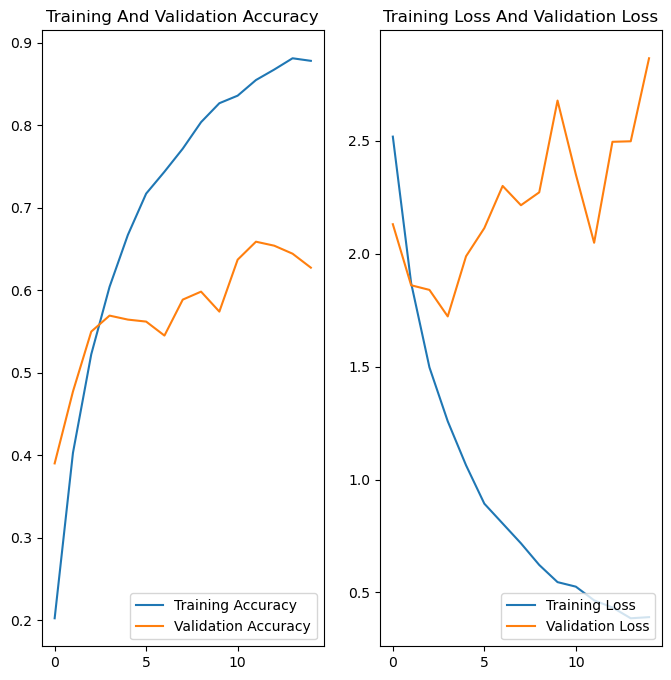

In [31]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)
plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc = 'lower right')
plt.title('Training And Validation Accuracy')


plt.subplot(1,2,2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc = 'lower right')
plt.title('Training Loss And Validation Loss')

plt.show()

# 3rd time

In [32]:
model = Sequential(
    [
        data_augmentation,
        layers.Rescaling (1./255),
        layers.Conv2D(16, 3, padding='same', activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(32, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(64, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Dropout(0.4),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(num_classes, activation='softMax'.lower())
    ]
)

model.compile(
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer = 'adam',
    metrics = ['accuracy']
)

In [33]:
epochs = 10

history = model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = epochs
)

Epoch 1/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 396s 2s/step - accuracy: 0.1570 - loss: 2.6660 - val_accuracy: 0.4165 - val_loss: 2.1730
Epoch 2/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 341s 2s/step - accuracy: 0.4030 - loss: 1.9050 - val_accuracy: 0.4383 - val_loss: 2.0127
Epoch 3/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 340s 2s/step - accuracy: 0.4932 - loss: 1.5829 - val_accuracy: 0.4479 - val_loss: 1.9985
Epoch 4/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 330s 2s/step - accuracy: 0.5853 - loss: 1.2926 - val_accuracy: 0.5569 - val_loss: 1.7367
Epoch 5/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 340s 2s/step - accuracy: 0.6626 - loss: 1.0781 - val_accuracy: 0.5787 - val_loss: 1.6710
Epoch 6/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 338s 2s/step - accuracy: 0.7049 - loss: 0.9448 - val_accuracy: 0.5811 - val_loss: 1.7753
Epoch 7/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 372s 2s/step - accuracy: 0.7378 - loss: 0.8181 - val_accuracy: 0.5714 - val_loss: 1.9007
Epoch 8/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 359s 2s/step - accuracy: 0.7766 - loss: 0.7208 - val_accu

In [34]:
model = Sequential(
    [
        data_augmentation,
        layers.Rescaling (1./255),
        layers.Conv2D(16, 3, padding='same', activation='relu'),
        layers.MaxPooling2D(),
        layers.Dropout(0.2),
        layers.Conv2D(32, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(64, 3, padding='saMe'.lower(), activation='relu'),
        layers.MaxPooling2D(),
        layers.Dropout(0.4),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(num_classes, activation='softMax'.lower())
    ]
)

model.compile(
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer = 'adam',
    metrics = ['accuracy']
)

In [35]:
epochs = 10

history = model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = epochs
)

Epoch 1/10


c:\Users\HP\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\nn.py:678: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


202/202 ━━━━━━━━━━━━━━━━━━━━ 459s 2s/step - accuracy: 0.1137 - loss: 3.1278 - val_accuracy: 0.1889 - val_loss: 2.5586
Epoch 2/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 393s 2s/step - accuracy: 0.2805 - loss: 2.2645 - val_accuracy: 0.3099 - val_loss: 2.1327
Epoch 3/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 511s 3s/step - accuracy: 0.4072 - loss: 1.8468 - val_accuracy: 0.4649 - val_loss: 1.8588
Epoch 4/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 380s 2s/step - accuracy: 0.4830 - loss: 1.5925 - val_accuracy: 0.4939 - val_loss: 1.8549
Epoch 5/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 424s 2s/step - accuracy: 0.5457 - loss: 1.4223 - val_accuracy: 0.4576 - val_loss: 1.8215
Epoch 6/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 682s 3s/step - accuracy: 0.5669 - loss: 1.3420 - val_accuracy: 0.5085 - val_loss: 1.8190
Epoch 7/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 16288s 81s/step - accuracy: 0.6163 - loss: 1.2179 - val_accuracy: 0.5303 - val_loss: 1.8408
Epoch 8/10
202/202 ━━━━━━━━━━━━━━━━━━━━ 747s 4s/step - accuracy: 0.6416 - loss: 1.1132 - val_accuracy: 0.

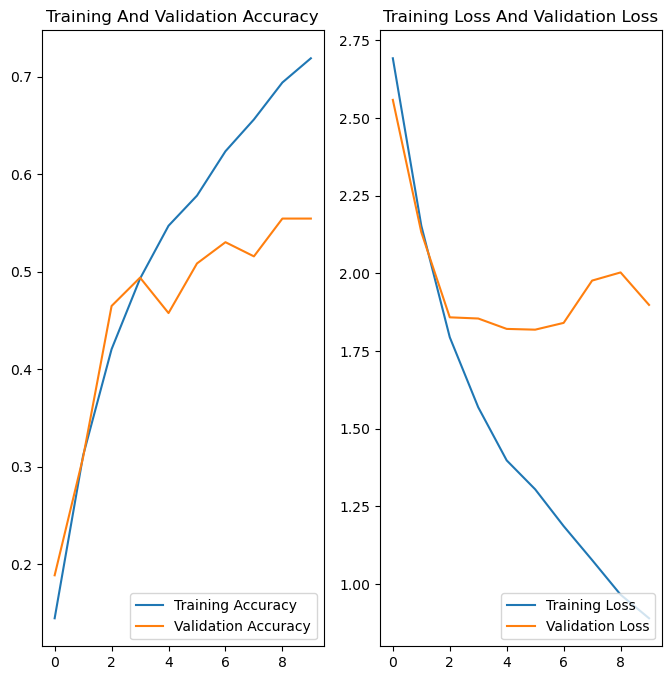

In [36]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)
plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc = 'lower right')
plt.title('Training And Validation Accuracy')


plt.subplot(1,2,2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc = 'lower right')
plt.title('Training Loss And Validation Loss')

plt.show()

### Working with an EfficientNet

In [135]:
from tensorflow.keras.applications import EfficientNetB0, EfficientNetV2B1
from tensorflow.keras import layers, models

In [136]:
image_size = (240, 240)
batch_size = 32


train_ds = image_dataset_from_directory(
    directory = train_dir_path,
    shuffle = True,
    batch_size = batch_size,
    image_size = image_size
)


val_ds = image_dataset_from_directory(
    directory = val_dir_path,
    batch_size = batch_size,
    image_size = image_size
)


test_ds = image_dataset_from_directory(
    directory = test_dir_path,
    batch_size = batch_size,
    image_size = image_size
)

Found 6443 files belonging to 17 classes.
Found 413 files belonging to 17 classes.
Found 379 files belonging to 17 classes.


### Define AUTOTUNE

In [137]:
AUTOTUNE = tf.data.AUTOTUNE 

train_ds = train_ds.cache().prefetch(buffer_size= AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size = AUTOTUNE)
test_ds = test_ds.cache().prefetch(buffer_size = AUTOTUNE)

In [138]:
## Load Efficient

base_model = EfficientNetV2B1(include_top=False, weights='imagenet', input_shape=image_size + (3,))
base_model.trainable = False

"C:/Users/HP/OneDrive/Desktop/project-folder/jute_pest_class/jute+pest+dataset/Jute_Pest_Dataset/test/Jute Aphid/Aug_Aphis gossypii Glover_147.jpg"

In [139]:
model = Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dropout(0.3),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(num_classes, activation='softmax')
    ]
)


model.compile(
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.001),
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)


epochs = 8

history = model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = epochs
)

Epoch 1/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 800s 4s/step - accuracy: 0.5996 - loss: 1.3426 - val_accuracy: 0.8717 - val_loss: 0.4053
Epoch 2/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 746s 4s/step - accuracy: 0.9252 - loss: 0.2616 - val_accuracy: 0.8886 - val_loss: 0.3526
Epoch 3/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 669s 3s/step - accuracy: 0.9502 - loss: 0.1781 - val_accuracy: 0.9080 - val_loss: 0.3213
Epoch 4/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 709s 4s/step - accuracy: 0.9602 - loss: 0.1285 - val_accuracy: 0.9225 - val_loss: 0.3044
Epoch 5/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 685s 3s/step - accuracy: 0.9670 - loss: 0.1099 - val_accuracy: 0.9128 - val_loss: 0.3064
Epoch 6/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 680s 3s/step - accuracy: 0.9755 - loss: 0.0866 - val_accuracy: 0.9249 - val_loss: 0.3061
Epoch 7/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 668s 3s/step - accuracy: 0.9792 - loss: 0.0773 - val_accuracy: 0.8862 - val_loss: 0.3344
Epoch 8/8
202/202 ━━━━━━━━━━━━━━━━━━━━ 446s 2s/step - accuracy: 0.9771 - loss: 0.0709 - val_accuracy: 0.

### Plotting the model performance

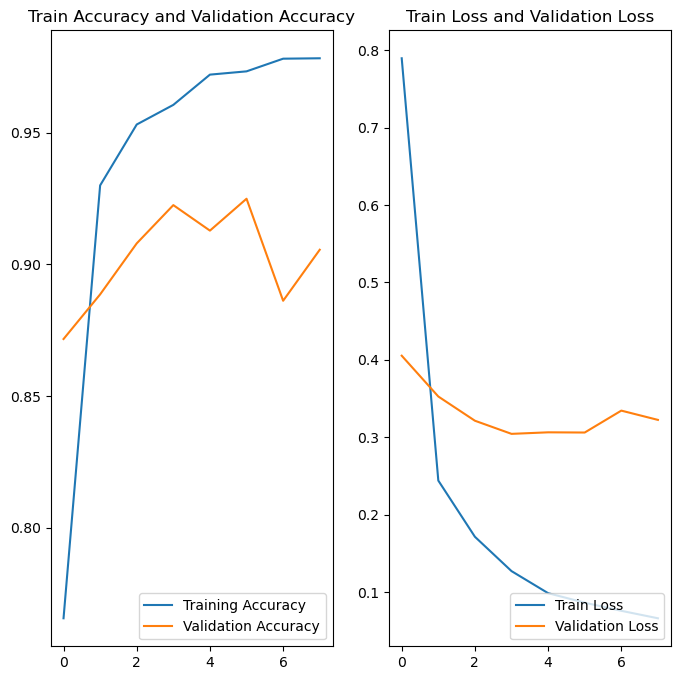

In [140]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']


loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Train Accuracy and Validation Accuracy')


plt.subplot(1,2, 2)
plt.plot(epochs_range, loss, label='Train Loss')
plt.plot(epochs_range, val_loss, label= 'Validation Loss')
plt.legend(loc = 'lower right')
plt.title('Train Loss and Validation Loss')

plt.show()


### making a few predictions

In [141]:
from tensorflow.keras.utils import load_img, img_to_array
import os

In [142]:
import numpy as np

In [147]:
def preprocess_img(file_path : str):
    
    try:
        if file_path:
            ### Image preprocessing
            img_obj = load_img(file_path, target_size = image_size)
            img_arr = img_to_array(img_obj)
            print(f'Before Expansion: {img_arr.shape} \n')
            img_arr = np.expand_dims(img_arr, axis=0)
            # print(f'After Expansion Expansion: {img_arr.shape} \n')
            # img_arr = img_arr / 255.0
            return img_arr
    except TypeError:
        return f'The File_path should be a str'
    except FileNotFoundError:
        return f'File not found'

In [148]:
def get_path(test_dir_path, file_name):
    try:
        file_path = os.path.normpath(os.path.join(test_dir_path, file_name))
        
        if os.path.exists(file_path):
            return file_path
        else:
            raise FileNotFoundError(f'File Not Found: {file_path}')
    except FileNotFoundError as FE:
        return str(FE)


file_path = get_path(test_dir_path=test_dir_path, file_name='Scopula Emissaria\Aug_Scopula emissaria Walker_204.jpg')

<>:13: SyntaxWarning: invalid escape sequence '\A'
<>:13: SyntaxWarning: invalid escape sequence '\A'
C:\Users\HP\AppData\Local\Temp\ipykernel_3044\2932903466.py:13: SyntaxWarning: invalid escape sequence '\A'
  file_path = get_path(test_dir_path=test_dir_path, file_name='Scopula Emissaria\Aug_Scopula emissaria Walker_204.jpg')


In [149]:
img_arr = preprocess_img(file_path)

predictions = model.predict(img_arr)

Before Expansion: (240, 240, 3) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


In [151]:
class_names[np.argmax(predictions)]

'Scopula Emissaria'

In [2]:
'm'.upper()

'M'

In [4]:
import os
model_dir = os.path.join(os.getcwd(), 'checks')
print(model_dir)

c:\Users\HP\OneDrive\Desktop\project-folder\jute_pest_class\checks


In [152]:
file_path_2 = get_path(test_dir_path, file_name='Jute Stem Girdler\Aug_Nupserha bicolor (Dutta)_251.jpg')

img_arr = preprocess_img(file_path_2)
predictions = model.predict(img_arr)

print(class_names[np.argmax(predictions)])

<>:1: SyntaxWarning: invalid escape sequence '\A'
<>:1: SyntaxWarning: invalid escape sequence '\A'
C:\Users\HP\AppData\Local\Temp\ipykernel_3044\3309560701.py:1: SyntaxWarning: invalid escape sequence '\A'
  file_path_2 = get_path(test_dir_path, file_name='Jute Stem Girdler\Aug_Nupserha bicolor (Dutta)_251.jpg')


Before Expansion: (240, 240, 3) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
Jute Stem Girdler
